### Author : A. N. M. Sajedul Alam
### Goal : Real time color detection using OpenCV
### Limitation: This can only detect three colors. Red, Green and Blue. Unfortunately didn't get time to work with all colors for now.

#### Mounting drive from accessing my video files

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#### Directly going to the folder where my things are

In [ ]:
%cd /content/drive/MyDrive/Real Time Color Detection/

/content/drive/.shortcut-targets-by-id/1DUEAs9tdwgTI9Z9BDNDEzwBlawxnYNOc/Real Time Color Detection


In [ ]:
!pwd

/content/drive/.shortcut-targets-by-id/1DUEAs9tdwgTI9Z9BDNDEzwBlawxnYNOc/Real Time Color Detection


In [ ]:
!ls

'color detection.py'				 video.mp4
 filename.avi					 video-new
 new_video.mp4					 video_short.mp4
'Real Time Color Detection Using OpenCV.ipynb'


In [ ]:
!pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### The main reason behind importing cv2_imshow is that google colab has issues with .imshow() function. So, that's why I needed to import another library here to support my code

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np 

### Taking my video input into the variable cap

In [ ]:
cap = cv2.VideoCapture('/content/drive/.shortcut-targets-by-id/1DUEAs9tdwgTI9Z9BDNDEzwBlawxnYNOc/Real Time Color Detection/video_short.mp4')

In [ ]:
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

In [ ]:
size = (frame_width, frame_height)

In [ ]:
# saving the outputs from each frame by frame in this 'result' variable, so that in the end i can generate the output video which will be 'filename.avi'
result = cv2.VideoWriter('filename.avi', 
                         cv2.VideoWriter_fourcc(*'MJPG'),
                         10, size)

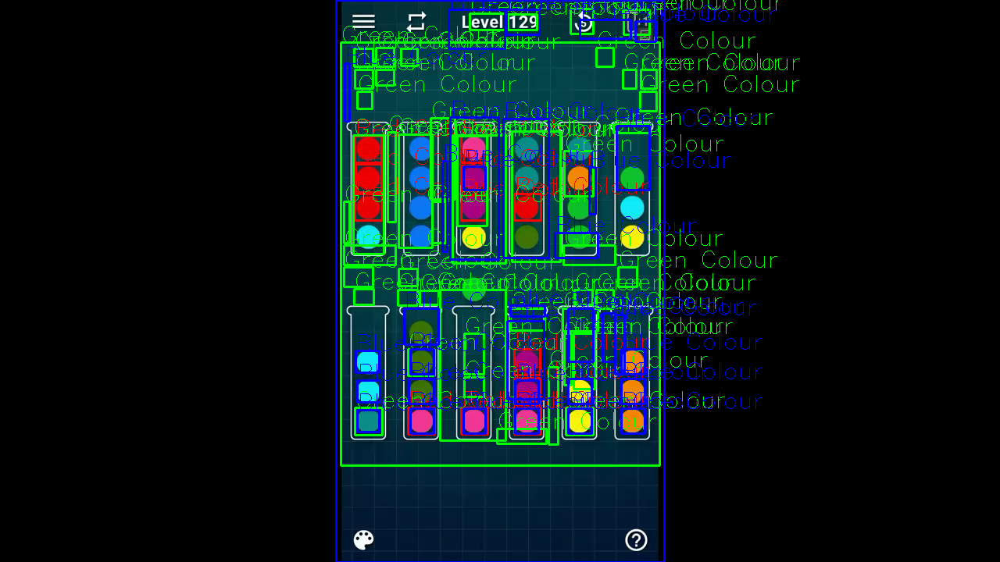

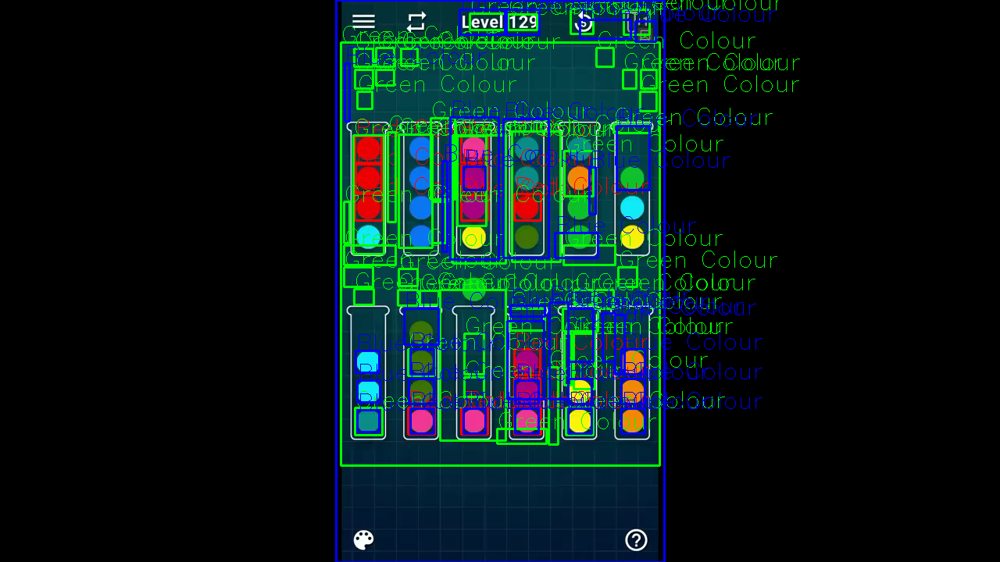

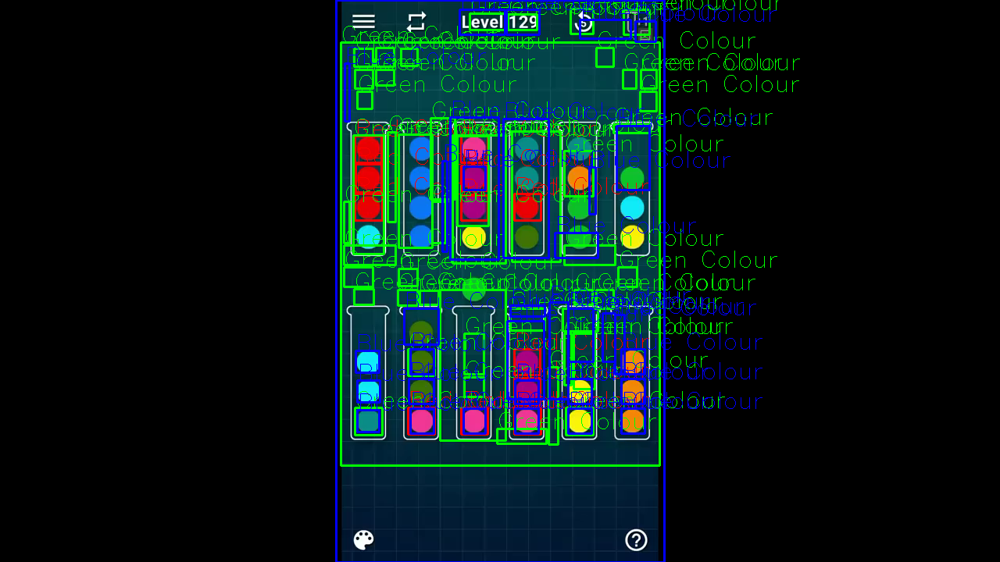

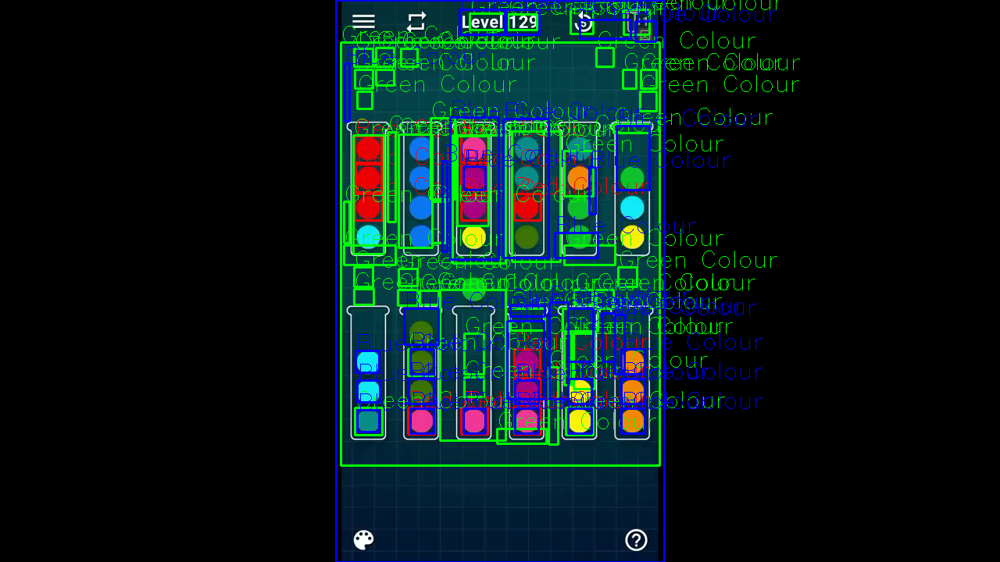

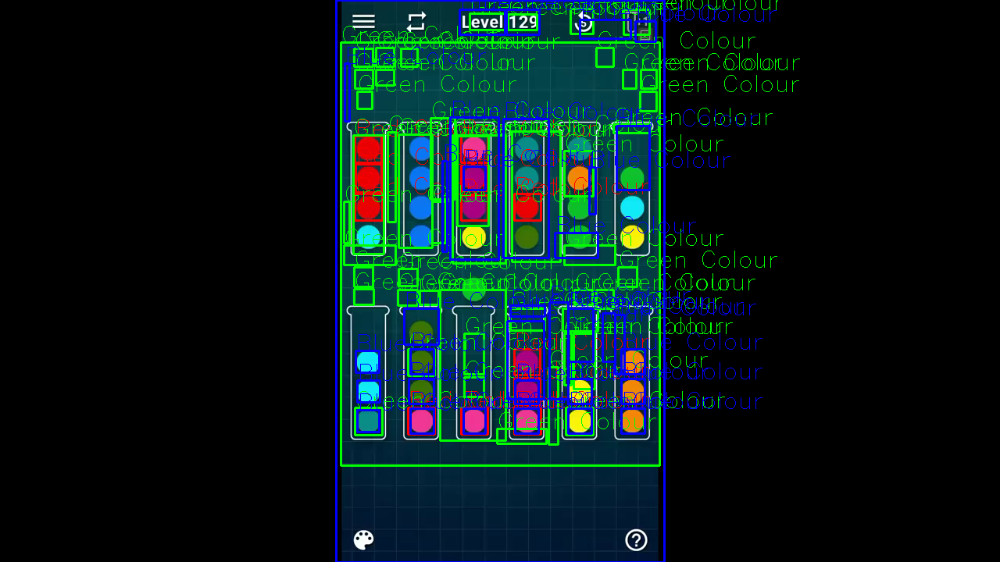

...

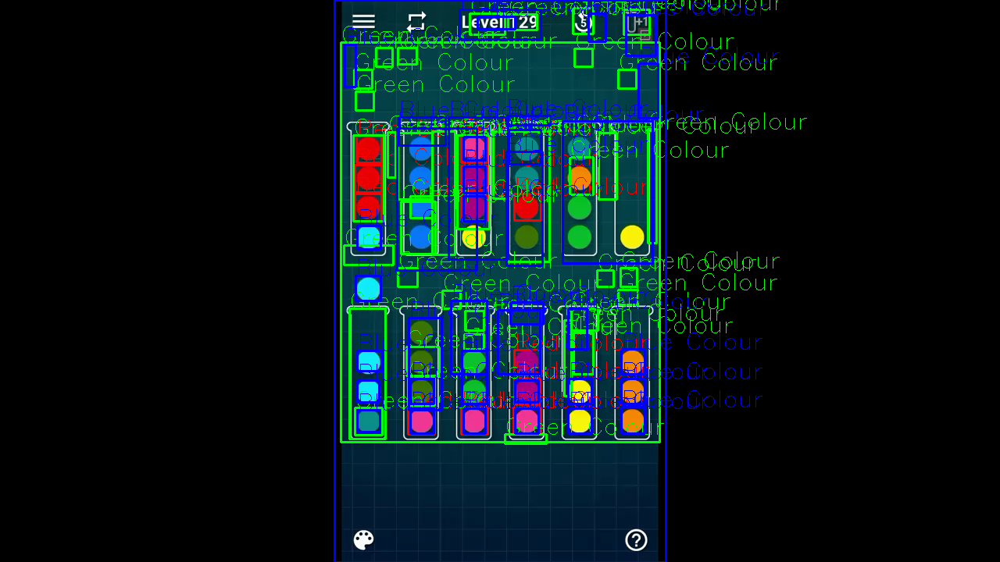

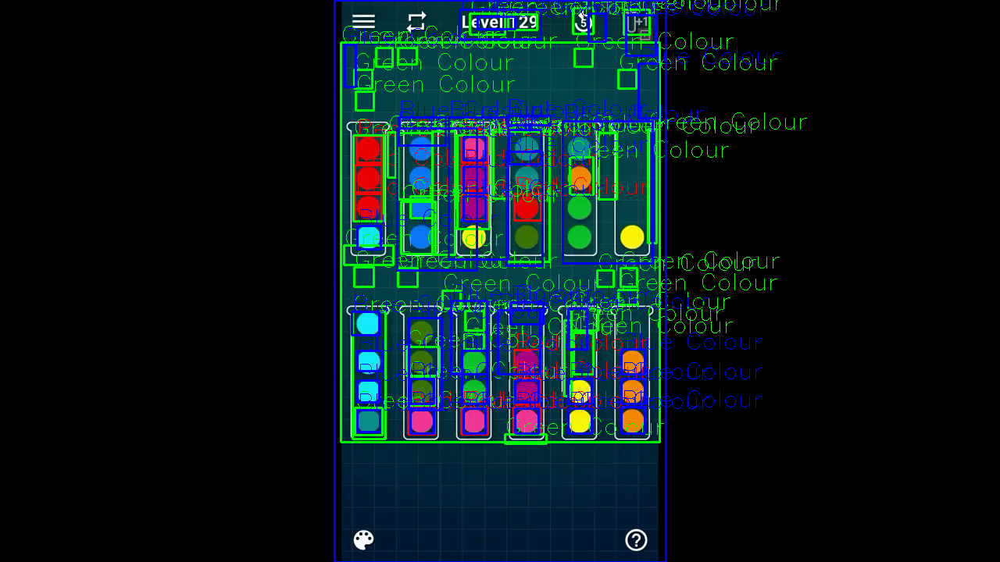

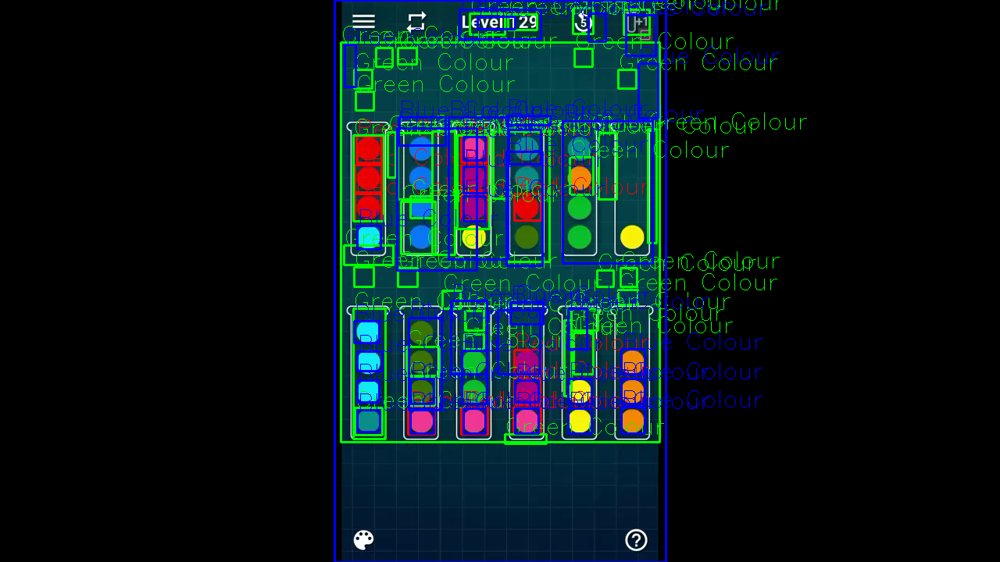

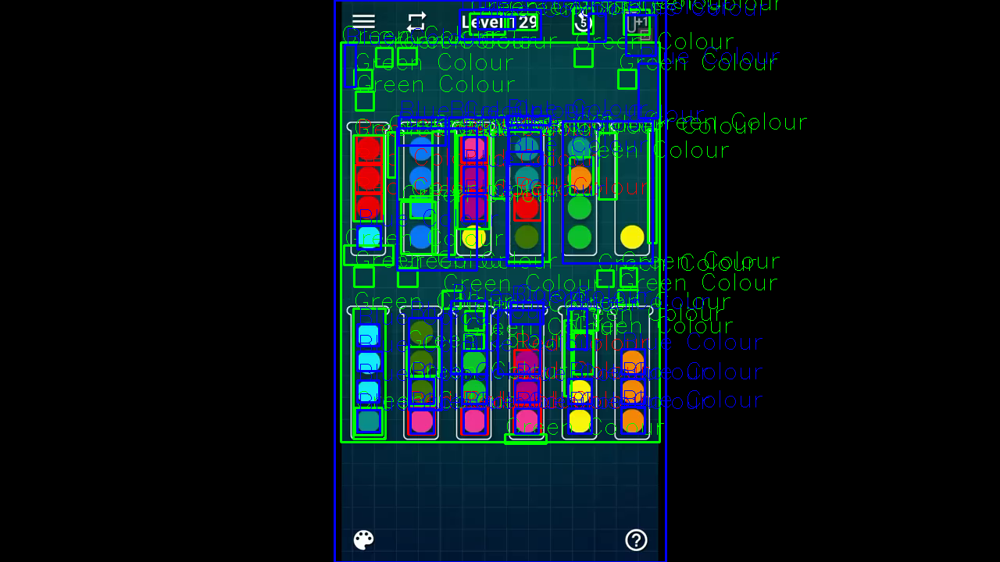

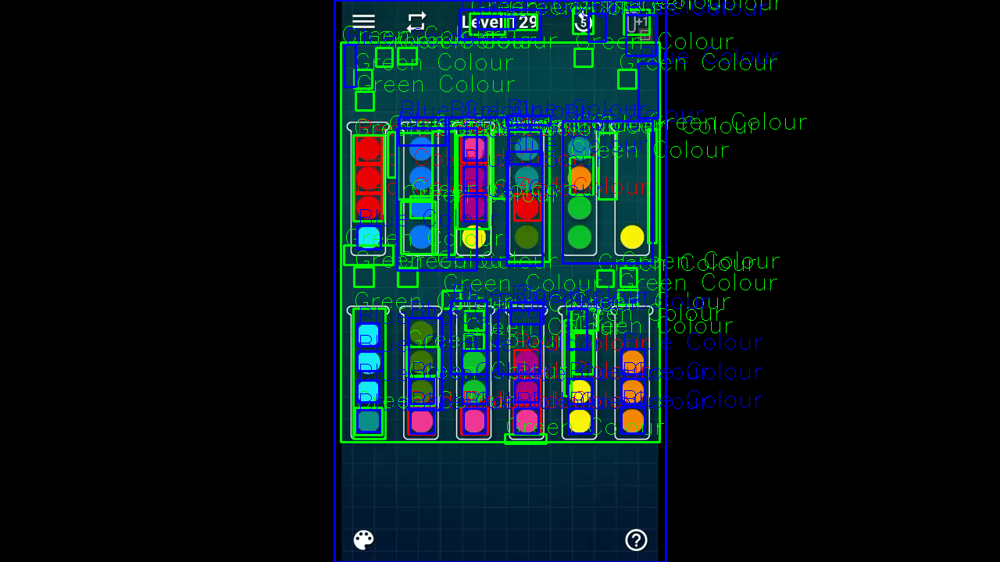

error: ignored

In [ ]:
# from here starting the loop which will basically tracking the colors.
while(1): 
	
	# keeping the video in imageFrame
	_, imageFrame = cap.read() 

	# converting the video, i mean imageFrame in BGR(RGB color space) to HSV(hue-saturation-value) color space, why? because we will work with HSV. 
	hsvFrame = cv2.cvtColor(imageFrame, cv2.COLOR_BGR2HSV) 

	# setting ranges for red color and defining it's masks.
	red_lower = np.array([136, 87, 111], np.uint8) 
	red_upper = np.array([180, 255, 255], np.uint8) 
	red_mask = cv2.inRange(hsvFrame, red_lower, red_upper) 

	# setting ranges for green color and defining it's masks.
	green_lower = np.array([25, 52, 72], np.uint8) 
	green_upper = np.array([102, 255, 255], np.uint8) 
	green_mask = cv2.inRange(hsvFrame, green_lower, green_upper) 

	# setting ranges for blue color and defining it's masks.
	blue_lower = np.array([94, 80, 2], np.uint8) 
	blue_upper = np.array([120, 255, 255], np.uint8) 
	blue_mask = cv2.inRange(hsvFrame, blue_lower, blue_upper) 
	
	# here i'm using morphological transform, dilation for each color and bitwise_and operator between imageFrame (main video input) and mask determines to detect only that particular color 
	# btw, here is the documentation of morphological transform of OpenCV: https://docs.opencv.org/4.x/d9/d61/tutorial_py_morphological_ops.html, you can check this out, if you have some time.
	kernal = np.ones((5, 5), "uint8") 
	
	# this section is for red color
	red_mask = cv2.dilate(red_mask, kernal) 
	res_red = cv2.bitwise_and(imageFrame, imageFrame, 
							mask = red_mask) 
	
	# this section is for green color
	green_mask = cv2.dilate(green_mask, kernal) 
	res_green = cv2.bitwise_and(imageFrame, imageFrame, 
								mask = green_mask) 
	
	# this section is for blue color 
	blue_mask = cv2.dilate(blue_mask, kernal) 
	res_blue = cv2.bitwise_and(imageFrame, imageFrame, 
							mask = blue_mask) 

	# tracking red color by creating this countour 
	contours, hierarchy = cv2.findContours(red_mask, 
										cv2.RETR_TREE, 
										cv2.CHAIN_APPROX_SIMPLE) 
	
	for pic, contour in enumerate(contours): 
		area = cv2.contourArea(contour) 
		if(area > 300): 
			x, y, w, h = cv2.boundingRect(contour) 
			imageFrame = cv2.rectangle(imageFrame, (x, y), 
									(x + w, y + h), 
									(0, 0, 255), 2) 
			
			cv2.putText(imageFrame, "Red Colour", (x, y), 
						cv2.FONT_HERSHEY_SIMPLEX, 1.0, 
						(0, 0, 255))	 

	# tracking green color by creating this countour 
	contours, hierarchy = cv2.findContours(green_mask, 
										cv2.RETR_TREE, 
										cv2.CHAIN_APPROX_SIMPLE) 
	
	for pic, contour in enumerate(contours): 
		area = cv2.contourArea(contour) 
		if(area > 300): 
			x, y, w, h = cv2.boundingRect(contour) 
			imageFrame = cv2.rectangle(imageFrame, (x, y), 
									(x + w, y + h), 
									(0, 255, 0), 2) 
			
			cv2.putText(imageFrame, "Green Colour", (x, y), 
						cv2.FONT_HERSHEY_SIMPLEX, 
						1.0, (0, 255, 0)) 

	# tracking blue color by creating this countour 
	contours, hierarchy = cv2.findContours(blue_mask, 
										cv2.RETR_TREE, 
										cv2.CHAIN_APPROX_SIMPLE) 
	for pic, contour in enumerate(contours): 
		area = cv2.contourArea(contour) 
		if(area > 300): 
			x, y, w, h = cv2.boundingRect(contour) 
			imageFrame = cv2.rectangle(imageFrame, (x, y), 
									(x + w, y + h), 
									(255, 0, 0), 2) 
			
			cv2.putText(imageFrame, "Blue Colour", (x, y), 
						cv2.FONT_HERSHEY_SIMPLEX, 
						1.0, (255, 0, 0)) 
			
	#Outputs:
	result.write(imageFrame) 
	cv2_imshow(imageFrame) 
	if cv2.waitKey(10) & 0xFF == ord('q'): 
		cap.release() 
		cv2.destroyAllWindows() 
		break